## Merge disparate data sources into a regression-ready dataset

> create a dataset of last 10 years of verified onshore grain size attrivuted by slope, slope uncertainty, and wave stats

Dan Buscombe (Marda / USGS) and Will Speiser (UC Davis)

#### import libraries

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import folium
import io
from PIL import Image
import os, time
# from selenium import webdriver
import geocoder
from tqdm import tqdm
import geopandas as gpd
import pygeos

Here enter in the distance that you'll want your joins filtered to. This is in decimal degrees (.0015 is approx 100m)

In [2]:
join_dist=.0015

In [157]:
# coastsat_dat = pd.read_csv('../coastsat_locations_and_slopes.csv')
path='./data/CGRASP' #str(os.getcwd())

cgrasp_dat = pd.read_csv(path+'/Data_Post2012_VerifiedOnshore.csv')
# cgrasp_dat = pd.read_csv(path+'/Data_VerifiedOnshore.csv')
sand = cgrasp_dat[cgrasp_dat['d50']<2]

In [158]:
### older codes used to make slopes / transects file

In [159]:
# transect_MD=pd.DataFrame(gpd.read_file('../usa_southeast_origins_MD.geojson').to_crs(epsg=4326))
# transect_DE=pd.DataFrame(gpd.read_file('../usa_southeast_origins_DE.geojson').to_crs(epsg=4326))
# transect_SC=pd.DataFrame(gpd.read_file('../usa_southeast_origins_SC.geojson').to_crs(epsg=4326))
# transect_FL=pd.DataFrame(gpd.read_file('../usa_southeast_origins_FL.geojson').to_crs(epsg=4326))
# transect_NC=pd.DataFrame(gpd.read_file('../usa_southeast_origins_NC.geojson').to_crs(epsg=4326))
# transect_VA_south=pd.DataFrame(gpd.read_file('../usa_southeast_origins_VA_south.geojson').to_crs(epsg=4326))
# transect_VA_north=pd.DataFrame(gpd.read_file('../usa_southeast_origins_VA_north.geojson').to_crs(epsg=4326))
# transect_GA=pd.DataFrame(gpd.read_file('../usa_southeast_origins_GA.geojson').to_crs(epsg=4326))

In [160]:
# transects=pd.concat([transect_DE,transect_FL,transect_GA,transect_MD,transect_NC,transect_SC,transect_VA_south,transect_VA_north
#                     ])

In [161]:
# transects["longitude"] = transects.geometry.map(lambda p: p.x)
# transects["latitude"] = transects.geometry.map(lambda p: p.y)

In [162]:
# slope=pd.read_csv('../coastsat_locations_and_slopes.csv')
# slope['id']=slope['coastsat_tr_name']

In [163]:
# slopes=pd.merge(transects, slope, on='id') 

In [164]:
# slopes = slopes[coastsat_dat['tanBeta']<1]

In [165]:
# slopes.keys()

In [166]:
# slopes.to_csv('Atlantic_coastsat_latlon_transects_and_slopes.csv')

In [167]:
#Enter the path to the coastsat slope csv here
# slopes = pd.read_csv(path+'/Atlantic_coastsat_latlon_transects_and_slopes.csv')

In [168]:
# cs_lats = slopes['latitude']
# cs_lons = slopes['longitude']

### Merge slopes with grain sizes

In [169]:
slopes2 = pd.DataFrame(gpd.read_file('./data/beach_slopes/US_East_coast_slopes_by_transect.geojson'))

In [170]:
slopes2['points'] = slopes2.apply(lambda x: [y for y in x['geometry'].coords], axis=1)

In [171]:
latlon = np.vstack([np.mean(s,axis=0) for s in slopes2.points.values])

cs_lons = latlon[:,0]
cs_lats = latlon[:,1]

In [172]:
# slopes2.longitude = cs_lons
# slopes2.latitude = cs_lats
slopes2.insert(2, "longitude", cs_lons, True)
slopes2.insert(3, "latitude", cs_lats, True)

In [173]:
slopes2

,id,site_id,longitude,latitude,beach_slope,lower_conf_bound,upper_conf_bound,width_ci,quality_flag,sl_points,trend,geometry,points
0,usa_DE_0001_0001,usa_DE_0001,-75.046622,38.451502,0.080,0.0666,0.0951,0.0285,Medium,640.0,0.445254,"LINESTRING (-75.05014 38.45161, -75.04310 38.4...","[(-75.05014020783311, 38.451606501975476), (-7..."
1,usa_DE_0001_0002,usa_DE_0001,-75.046609,38.451956,0.075,0.0638,0.0892,0.0254,Medium,638.0,0.538956,"LINESTRING (-75.05013 38.45206, -75.04308 38.4...","[(-75.05013362259639, 38.45205566241574), (-75..."
2,usa_DE_0001_0003,usa_DE_0001,-75.046597,38.452408,0.075,0.0653,0.0920,0.0267,Medium,643.0,0.569271,"LINESTRING (-75.05013 38.45251, -75.04307 38.4...","[(-75.05012703103513, 38.45250524883383), (-75..."
3,usa_DE_0001_0004,usa_DE_0001,-75.046585,38.452860,0.075,0.0636,0.0936,0.0300,Medium,650.0,0.614094,"LINESTRING (-75.05012 38.45296, -75.04305 38.4...","[(-75.05012043279025, 38.4529552857037), (-75...."
4,usa_DE_0001_0005,usa_DE_0001,-75.046571,38.453311,0.075,0.0628,0.0912,0.0284,Medium,637.0,0.661448,"LINESTRING (-75.05011 38.45341, -75.04303 38.4...","[(-75.0501094070558, 38.45340567036367), (-75...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
34062,usa_VA_0020_0331,usa_VA_0020,-75.242015,38.024347,0.070,0.0584,0.0896,0.0312,Medium,419.0,-1.020350,"LINESTRING (-75.24505 38.02577, -75.23898 38.0...","[(-75.2450528012313, 38.02576852787062), (-75...."
34063,usa_VA_0020_0332,usa_VA_0020,-75.241723,38.024725,0.080,0.0649,0.0980,0.0331,Medium,421.0,-0.925495,"LINESTRING (-75.24474 38.02615, -75.23870 38.0...","[(-75.24474092120143, 38.0261511884087), (-75...."
34064,usa_VA_0020_0333,usa_VA_0020,-75.241429,38.025101,0.080,0.0658,0.0996,0.0338,Medium,420.0,-0.841109,"LINESTRING (-75.24443 38.02653, -75.23843 38.0...","[(-75.24442860127671, 38.02653438385075), (-75..."
34065,usa_VA_0020_0334,usa_VA_0020,-75.241133,38.025475,0.075,0.0625,0.0935,0.0310,Medium,419.0,-0.739024,"LINESTRING (-75.24412 38.02692, -75.23815 38.0...","[(-75.24411621208061, 38.0269176594551), (-75...."


#### visualize coinciednt slopes and grain sizes

In [174]:
map = folium.Map(
                location=[np.mean(lats), np.mean(lons)], 
                zoom_start=4, 
                control_scale=True,
                tiles='stamentoner',#tiles="Stamen Terrain", 
)

In [175]:
for counter, (lat,lon) in enumerate(zip(sand['latitude'],sand['longitude'])):
    folium.CircleMarker(location=[lat, lon],
                                radius = 3,
                                fill=True, # Set fill to True
                                color = 'red',
                                opacity=0.1,
                                fill_opacity=0.7).add_to(map)

In [176]:
for counter, (lat,lon) in enumerate(zip(cs_lats,cs_lons)):
    folium.CircleMarker(location=[lat, lon],
                                radius = 3,
                                fill=True, # Set fill to True
                                color = 'blue',
                                opacity=0.1,
                                fill_opacity=0.7).add_to(map)

In [177]:
map

In [178]:
# gdf_slopes = gpd.GeoDataFrame(
#     slopes, geometry=gpd.points_from_xy(slopes.longitude, slopes.latitude))

gdf_slopes = gpd.GeoDataFrame(
    slopes2, geometry=gpd.points_from_xy(slopes2.longitude, slopes2.latitude))


In [179]:
gdf_sand = gpd.GeoDataFrame(
    sand, geometry=gpd.points_from_xy(sand.longitude, sand.latitude))


In [180]:

# gs_w_slope_data=gpd.sjoin_nearest(gdf_sand, gdf_slopes, how='left', distance_col='distance')
gs_w_slope_data=gpd.sjoin_nearest(gdf_sand, gdf_slopes, how='right', distance_col='distance')


gs_w_slope_data

,index_left,ID,Sample_ID,Sample_Type_Code,Project,dataset,Date,Location_Type,latitude_left,longitude_left,...,beach_slope,lower_conf_bound,upper_conf_bound,width_ci,quality_flag,sl_points,trend,geometry,points,distance
0,1354,479504,Indian River Inlet Dune Toe,1,"SandSnap, image taken by: rose.dopsovic",sandsnap,2021-09-14,Beach?Y,38.61089,-75.06345,...,0.080,0.0666,0.0951,0.0285,Medium,640.0,0.445254,POINT (-75.04662 38.45150),"[(-75.05014020783311, 38.451606501975476), (-7...",0.160273
1,1354,479504,Indian River Inlet Dune Toe,1,"SandSnap, image taken by: rose.dopsovic",sandsnap,2021-09-14,Beach?Y,38.61089,-75.06345,...,0.075,0.0638,0.0892,0.0254,Medium,638.0,0.538956,POINT (-75.04661 38.45196),"[(-75.05013362259639, 38.45205566241574), (-75...",0.159824
2,1354,479504,Indian River Inlet Dune Toe,1,"SandSnap, image taken by: rose.dopsovic",sandsnap,2021-09-14,Beach?Y,38.61089,-75.06345,...,0.075,0.0653,0.0920,0.0267,Medium,643.0,0.569271,POINT (-75.04660 38.45241),"[(-75.05012703103513, 38.45250524883383), (-75...",0.159375
3,1354,479504,Indian River Inlet Dune Toe,1,"SandSnap, image taken by: rose.dopsovic",sandsnap,2021-09-14,Beach?Y,38.61089,-75.06345,...,0.075,0.0636,0.0936,0.0300,Medium,650.0,0.614094,POINT (-75.04658 38.45286),"[(-75.05012043279025, 38.4529552857037), (-75....",0.158928
4,1354,479504,Indian River Inlet Dune Toe,1,"SandSnap, image taken by: rose.dopsovic",sandsnap,2021-09-14,Beach?Y,38.61089,-75.06345,...,0.075,0.0628,0.0912,0.0284,Medium,637.0,0.661448,POINT (-75.04657 38.45331),"[(-75.0501094070558, 38.45340567036367), (-75....",0.158481
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34062,1353,475063,Assateague,1,"Brian McFall, sandsnap training round 1 March ...",sandsnap,2019-08-07,Beach?Y,38.19220,-75.15644,...,0.070,0.0584,0.0896,0.0312,Medium,419.0,-1.020350,POINT (-75.24202 38.02435),"[(-75.2450528012313, 38.02576852787062), (-75....",0.188409
34063,1353,475063,Assateague,1,"Brian McFall, sandsnap training round 1 March ...",sandsnap,2019-08-07,Beach?Y,38.19220,-75.15644,...,0.080,0.0649,0.0980,0.0331,Medium,421.0,-0.925495,POINT (-75.24172 38.02473),"[(-75.24474092120143, 38.0261511884087), (-75....",0.187939
34064,1353,475063,Assateague,1,"Brian McFall, sandsnap training round 1 March ...",sandsnap,2019-08-07,Beach?Y,38.19220,-75.15644,...,0.080,0.0658,0.0996,0.0338,Medium,420.0,-0.841109,POINT (-75.24143 38.02510),"[(-75.24442860127671, 38.02653438385075), (-75...",0.187471
34065,1353,475063,Assateague,1,"Brian McFall, sandsnap training round 1 March ...",sandsnap,2019-08-07,Beach?Y,38.19220,-75.15644,...,0.075,0.0625,0.0935,0.0310,Medium,419.0,-0.739024,POINT (-75.24113 38.02547),"[(-75.24411621208061, 38.0269176594551), (-75....",0.187003


In [181]:
merged_filtered = gs_w_slope_data[gs_w_slope_data['distance']<join_dist]

In [182]:
len(merged_filtered)

91

In [183]:
merged_filtered.keys()

Index(['index_left', 'ID', 'Sample_ID', 'Sample_Type_Code', 'Project',
       'dataset', 'Date', 'Location_Type', 'latitude_left', 'longitude_left',
       'Contact', 'num_orig_dists', 'Measured_Distributions', 'Grainsize',
       'Mean', 'Median', 'Wentworth', 'Kurtosis', 'Kurtosis_Class', 'Skewness',
       'Skewness_Class', 'Std', 'Sorting', 'd5', 'd10', 'd16', 'd25', 'd30',
       'd50', 'd65', 'd75', 'd84', 'd90', 'd95', 'Notes', 'id', 'site_id',
       'longitude_right', 'latitude_right', 'beach_slope', 'lower_conf_bound',
       'upper_conf_bound', 'width_ci', 'quality_flag', 'sl_points', 'trend',
       'geometry', 'points', 'distance'],
      dtype='object')

#### map of grain size samples that are coincident with a slope estimate

In [184]:
# merged_lats = np.mean(merged_filtered['latitude_right'],axis=1)
merged_lats = merged_filtered['latitude_right']
merged_lons = merged_filtered['longitude_right']
# merged_lats = np.mean(merged_filtered['latitude_left'],axis=1)
# merged_lons = merged_filtered['longitude_left']

In [185]:
map2 = folium.Map(
                location=[np.mean(lats), np.mean(lons)], 
                zoom_start=4, 
                control_scale=True,
                tiles='stamentoner',#tiles="Stamen Terrain", 
)

for counter, (lat,lon) in enumerate(zip(merged_lats,merged_lons)):
    folium.CircleMarker(location=[lat, lon],
                                radius = 3,
                                fill=True, # Set fill to True
                                color = 'red',
                                opacity=0.1,
                                fill_opacity=0.7).add_to(map2)

In [186]:
map2

In [187]:
merged_filtered['d50'].max()

1.04999896555506

In [188]:
bujan_dat = pd.read_csv('./data/bujan_et_al_data/Size-Slope-Data-Points.csv')
bujan_dat#.keys()

,Reference,Type,Clast size (mm),Slope (tan β),Clast size (Φ),Slope (°),Unnamed: 6
0,Bradbury1992,Beach,16.00,0.100,-4.000,5.71,NaN
1,Mason1989,Beach,2.60,0.095,-1.379,5.43,NaN
2,Mason1989,Beach,2.00,0.055,-1.000,3.15,NaN
3,Sherman1993,Beach,32.00,0.240,-5.000,13.50,NaN
4,Jennings2002,Beach,3.53,0.140,-1.820,7.97,NaN
...,...,...,...,...,...,...,...
2139,Komar1998,Beach,0.21,0.012,2.243,0.69,NaN
2140,Komar1998,Beach,0.19,0.011,2.395,0.63,NaN
2141,Komar1998,Beach,0.17,0.011,2.556,0.64,NaN
2142,Brayne2015,Beach,140.00,0.270,-7.129,15.11,NaN


In [189]:
bujan_sand = bujan_dat[bujan_dat['Clast size (mm)']<2]

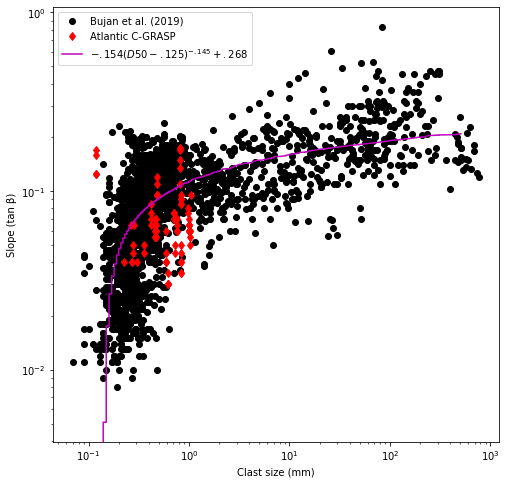

In [190]:
plt.figure(figsize=(8,8))
plt.loglog(bujan_dat['Clast size (mm)'], bujan_dat['Slope (tan β)'],'ko', label='Bujan et al. (2019)')
# plt.loglog(merged_filtered['d50'], merged_filtered['tanBeta'],'rd', label='Atlantic C-GRASP')
plt.loglog(merged_filtered['d50'], merged_filtered['beach_slope'],'rd', label='Atlantic C-GRASP')
plt.xlabel('Clast size (mm)')
plt.ylabel('Slope (tan β)')

a = -0.154
b = -0.145
c = 0.268
ln = a*( bujan_dat['Clast size (mm)'] - 0.125)**b + c

plt.plot(np.sort(bujan_dat['Clast size (mm)']), np.sort(ln),'m', label=r'$-.154(D50 - .125)^{-.145} + .268$')

plt.legend()

plt.savefig('CGRASP_d50-slope.jpg', dpi=300)

/tmp/ipykernel_1348556/1438162164.py:9: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim(0,2)


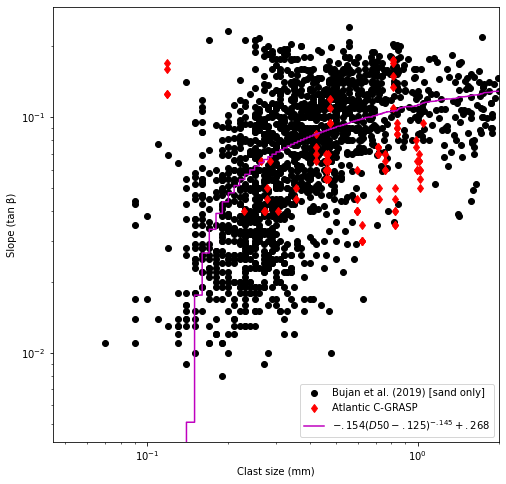

In [191]:


plt.figure(figsize=(8,8))
plt.loglog(bujan_sand['Clast size (mm)'], bujan_sand['Slope (tan β)'],'ko', label='Bujan et al. (2019) [sand only]')
# plt.loglog(merged_filtered['d50'], merged_filtered['tanBeta'],'rd', label='Atlantic C-GRASP')
plt.loglog(merged_filtered['d50'], merged_filtered['beach_slope'],'rd', label='Atlantic C-GRASP')
plt.xlabel('Clast size (mm)')
plt.ylabel('Slope (tan β)')

plt.plot(np.sort(bujan_dat['Clast size (mm)']), np.sort(ln),'m', label=r'$-.154(D50 - .125)^{-.145} + .268$')
plt.xlim(0,2)
plt.legend()
plt.savefig('CGRASP_d50-slope-sandonly.jpg', dpi=300)

### Merge wave data 

Now that sediments and slopes have been merged, lets combine them with wave data

The matlab file was a headache, so I seperated all the parameters into different csv's so we could deal with them individually. For each parameter with have the lat and lon point (lat & lon columns), and then each column is a date (labeled by column name) and the values under the column are the magnitude at the lat lon point on the  given date. This part is a little hacky, but it should work.

In [192]:
#Here we have all the datafiles that we created from the wave files. Seperated them by metric to make it easier.

dir_df=pd.read_csv('./data/WaveData/Dir.csv')
hsmax_df=pd.read_csv('./data/WaveData/HsMax.csv')
hsmean_df=pd.read_csv('./data/WaveData/HsMean.csv')
tp_df=pd.read_csv('./data/WaveData/Tp.csv')

In [193]:
dir_df = dir_df.rename(columns={"lat": "latitude", "lon": "longitude"})
hsmax_df = hsmax_df.rename(columns={"lat": "latitude", "lon": "longitude"})
hsmean_df = hsmean_df.rename(columns={"lat": "latitude", "lon": "longitude"})
tp_df = tp_df.rename(columns={"lat": "latitude", "lon": "longitude"})


### For example:

In [194]:
dir_df

,latitude,longitude,726834,726835,726836,726837,726838,726839,726840,726841,...,737537,737538,737539,737540,737541,737542,737543,737544,737545,737546
0,25.666561,-80.133240,122.258750,101.903749,71.880001,82.685000,99.517500,110.751249,128.742499,136.179999,...,75.233046,75.228045,75.231405,75.229725,75.228203,75.232109,75.229452,75.229452,75.229725,74.863747
1,25.733227,-80.133240,127.017502,103.802501,68.115000,82.505001,98.745001,112.017499,136.500001,140.390000,...,76.429335,76.427263,76.426718,76.426991,76.426445,76.427422,76.426718,76.425741,76.427967,76.621559
2,25.799894,-80.133240,114.761250,55.895000,64.623749,74.912500,97.240000,113.120000,131.837500,127.847500,...,75.930311,75.927263,75.928671,75.927967,75.927422,75.818047,75.927694,75.708944,75.926991,76.238747
3,25.866562,-80.133240,124.427500,58.188750,63.828749,80.771250,97.298750,110.467501,131.861250,155.124999,...,76.667616,76.665545,76.665976,76.667225,76.666679,76.664726,76.667929,76.665976,76.667225,76.098122
4,25.933229,-80.066574,154.616251,22.921250,21.953750,57.617500,110.552499,140.296249,159.210001,109.547501,...,65.683241,65.685076,65.682577,65.682850,65.685234,65.683281,65.684530,65.685507,65.682850,65.691872
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,38.533291,-74.999878,140.655001,131.960001,119.619999,138.682500,155.262499,118.855001,116.636251,105.970000,...,164.029922,164.030785,164.027306,164.026604,164.026054,164.028008,164.024376,164.026329,164.022697,164.020004
246,38.599957,-74.999878,137.152502,129.549997,119.045001,137.323748,152.073749,121.376250,116.067500,105.342501,...,162.334610,162.333519,162.329063,162.328361,162.327812,162.328789,162.327110,162.328087,162.327385,162.348129
247,38.666626,-74.999878,160.023748,127.923749,120.769999,138.090003,151.467499,123.755000,117.978749,106.059999,...,157.598282,157.598167,157.597618,157.597893,157.597343,157.597343,157.597618,157.597618,157.597893,157.613754
248,38.733292,-75.066551,146.713751,164.932504,112.121251,122.969999,114.223751,110.425000,110.080001,100.801250,...,144.538712,144.532738,144.539024,144.535393,144.532890,144.534843,144.532188,144.534142,144.535393,144.488754


Now we are going to want to rename those column names to yyyy-mm-dd format to match with the rest of the data (and be comprehensible to humans using the Gregorian calendar...)


In [195]:
#rename wave variable dataframe columns to yyyy-mm-dd format
i=0
for i in tqdm(range(0,len(dir_df.columns)-2)):
    focus_col=dir_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    dir_df=dir_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('dir done')
#rename wave variable dataframe columns to yyyy-mm-dd format
i=0
for i in tqdm(range(0,len(hsmax_df.columns)-2)):
    focus_col=hsmax_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    hsmax_df=hsmax_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('hsmax done')

i=0
for i in tqdm(range(0,len(hsmean_df.columns)-2)):
    focus_col=hsmean_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    hsmean_df=hsmean_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('hsmean done')

i=0
for i in tqdm(range(0,len(tp_df.columns)-2)):
    focus_col=tp_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    tp_df=tp_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('tp done')


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:42<00:00, 252.48it/s]


dir done


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:43<00:00, 249.11it/s]


hsmax done


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:41<00:00, 255.11it/s]


hsmean done


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:41<00:00, 255.52it/s]

tp done


In [196]:
tp_df

,latitude,longitude,1990-01-01,1990-01-02,1990-01-03,1990-01-04,1990-01-05,1990-01-06,1990-01-07,1990-01-08,...,2019-04-22,2019-04-23,2019-04-24,2019-04-25,2019-04-26,2019-04-27,2019-04-28,2019-04-29,2019-04-30,2019-05-01
0,25.666561,-80.133240,4.05125,4.91875,5.31000,5.63000,4.26250,4.11875,3.50125,3.54125,...,5.349766,5.347813,5.347813,5.347813,5.347813,5.347813,5.347813,5.347813,5.347813,5.355625
1,25.733227,-80.133240,3.87250,5.02125,5.70500,5.58250,4.20375,4.08250,3.38375,3.49625,...,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.355625
2,25.799894,-80.133240,4.56750,5.24625,5.75125,6.12750,4.24125,3.95375,2.96500,3.52625,...,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750
3,25.866562,-80.133240,3.82375,5.14125,5.74750,5.51750,4.22625,4.12500,2.90000,2.45875,...,5.418125,5.418125,5.418125,5.418125,5.418125,5.414219,5.414219,5.414219,5.414219,5.433750
4,25.933229,-80.066574,4.20125,6.10000,7.02375,6.32625,4.41625,4.31375,3.87625,5.07375,...,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,38.533291,-74.999878,8.51625,9.36750,9.24500,7.49750,6.76875,9.54125,9.25375,7.88625,...,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000
246,38.599957,-74.999878,8.38750,9.30125,9.25000,7.45000,6.78125,9.17875,9.21625,7.79875,...,5.394688,5.394688,5.398594,5.402500,5.402500,5.402500,5.402500,5.402500,5.402500,5.402500
247,38.666626,-74.999878,7.53000,9.41125,9.23625,7.41500,6.76875,9.14875,9.20125,7.75125,...,5.459141,5.461094,5.463047,5.465000,5.465000,5.465000,5.465000,5.465000,5.465000,5.465000
248,38.733292,-75.066551,7.65375,8.00625,9.41375,7.97875,6.99500,9.72375,9.27250,7.72375,...,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875


In [224]:
len(tp_df)

250

#### merge waves and slopes for independent variables

In [297]:
df=slopes2.copy()
df=pd.DataFrame(df)

df

,id,site_id,longitude,latitude,beach_slope,lower_conf_bound,upper_conf_bound,width_ci,quality_flag,sl_points,trend,geometry,points
0,usa_DE_0001_0001,usa_DE_0001,-75.046622,38.451502,0.080,0.0666,0.0951,0.0285,Medium,640.0,0.445254,POINT (-75.04662 38.45150),"[(-75.05014020783311, 38.451606501975476), (-7..."
1,usa_DE_0001_0002,usa_DE_0001,-75.046609,38.451956,0.075,0.0638,0.0892,0.0254,Medium,638.0,0.538956,POINT (-75.04661 38.45196),"[(-75.05013362259639, 38.45205566241574), (-75..."
2,usa_DE_0001_0003,usa_DE_0001,-75.046597,38.452408,0.075,0.0653,0.0920,0.0267,Medium,643.0,0.569271,POINT (-75.04660 38.45241),"[(-75.05012703103513, 38.45250524883383), (-75..."
3,usa_DE_0001_0004,usa_DE_0001,-75.046585,38.452860,0.075,0.0636,0.0936,0.0300,Medium,650.0,0.614094,POINT (-75.04658 38.45286),"[(-75.05012043279025, 38.4529552857037), (-75...."
4,usa_DE_0001_0005,usa_DE_0001,-75.046571,38.453311,0.075,0.0628,0.0912,0.0284,Medium,637.0,0.661448,POINT (-75.04657 38.45331),"[(-75.0501094070558, 38.45340567036367), (-75...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
34062,usa_VA_0020_0331,usa_VA_0020,-75.242015,38.024347,0.070,0.0584,0.0896,0.0312,Medium,419.0,-1.020350,POINT (-75.24202 38.02435),"[(-75.2450528012313, 38.02576852787062), (-75...."
34063,usa_VA_0020_0332,usa_VA_0020,-75.241723,38.024725,0.080,0.0649,0.0980,0.0331,Medium,421.0,-0.925495,POINT (-75.24172 38.02473),"[(-75.24474092120143, 38.0261511884087), (-75...."
34064,usa_VA_0020_0333,usa_VA_0020,-75.241429,38.025101,0.080,0.0658,0.0996,0.0338,Medium,420.0,-0.841109,POINT (-75.24143 38.02510),"[(-75.24442860127671, 38.02653438385075), (-75..."
34065,usa_VA_0020_0334,usa_VA_0020,-75.241133,38.025475,0.075,0.0625,0.0935,0.0310,Medium,419.0,-0.739024,POINT (-75.24113 38.02547),"[(-75.24411621208061, 38.0269176594551), (-75...."


In [298]:
df= gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.longitude, df.latitude))

In [270]:
dir_gdf= gpd.GeoDataFrame(
    dir_df, geometry=gpd.points_from_xy(dir_df.longitude, dir_df.latitude))

# dirmerge=gpd.sjoin_nearest(df, dir_gdf, how='left', distance_col='distance')
dirmerge=gpd.sjoin_nearest(df, dir_gdf, how='right', distance_col='distance')

filter_col = [col for col in dirmerge if col.startswith('20')]
dirmerge.insert(0, "dir", dirmerge[filter_col].mean(axis=1).values, True)

# dirmerge

In [271]:
hsmean_gdf= gpd.GeoDataFrame(
    hsmean_df, geometry=gpd.points_from_xy(hsmean_df.longitude, hsmean_df.latitude))

hsmeanmerge=gpd.sjoin_nearest(df, hsmean_gdf, how='right', distance_col='distance')

filter_col = [col for col in hsmeanmerge if col.startswith('20')]
hsmeanmerge.insert(0, "hs_mean", hsmeanmerge[filter_col].mean(axis=1).values, True)

# hsmeanmerge

In [272]:
hsmax_gdf= gpd.GeoDataFrame(
    hsmax_df, geometry=gpd.points_from_xy(hsmax_df.longitude, hsmax_df.latitude))

hsmaxmerge=gpd.sjoin_nearest(df, hsmax_gdf, how='right', distance_col='distance')

filter_col = [col for col in hsmaxmerge if col.startswith('20')]
hsmaxmerge.insert(0, "hs_max", hsmaxmerge[filter_col].mean(axis=1).values, True)

# hsmaxmerge

In [273]:
tp_gdf= gpd.GeoDataFrame(
    tp_df, geometry=gpd.points_from_xy(tp_df.longitude, tp_df.latitude))

tpmerge=gpd.sjoin_nearest(df, tp_gdf, how='right', distance_col='distance')

filter_col = [col for col in tpmerge if col.startswith('20')]
tpmerge.insert(0, "tp", tpmerge[filter_col].mean(axis=1).values, True)

# tpmerge

In [274]:
tpmerge

,tp,index_left,id,site_id,longitude_left,latitude_left,beach_slope,lower_conf_bound,upper_conf_bound,width_ci,...,2019-04-24,2019-04-25,2019-04-26,2019-04-27,2019-04-28,2019-04-29,2019-04-30,2019-05-01,geometry,distance
0,5.683104,805,usa_FL_0001_0012,usa_FL_0001,-80.152381,25.670353,0.130,0.1046,0.1776,0.0730,...,5.347813,5.347813,5.347813,5.347813,5.347813,5.347813,5.347813,5.355625,POINT (-80.13324 25.66656),0.019513
1,5.777092,949,usa_FL_0002_0016,usa_FL_0002,-80.143495,25.739017,0.085,0.0716,0.1016,0.0300,...,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.355625,POINT (-80.13324 25.73323),0.011777
2,6.142301,1060,usa_FL_0004_0075,usa_FL_0004,-80.124679,25.797382,0.125,0.0992,0.1655,0.0663,...,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,POINT (-80.13324 25.79989),0.008922
3,5.996293,1219,usa_FL_0004_0234,usa_FL_0004,-80.118116,25.868185,0.105,0.0860,0.1392,0.0532,...,5.418125,5.418125,5.418125,5.414219,5.414219,5.414219,5.414219,5.433750,POINT (-80.13324 25.86656),0.015211
4,6.648248,1373,usa_FL_0005_0086,usa_FL_0005,-80.118510,25.939522,NaN,NaN,NaN,NaN,...,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,POINT (-80.06657 25.93323),0.052316
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,7.605046,165,usa_DE_0002_0033,usa_DE_0002,-75.050394,38.526001,0.105,0.0693,0.2000,0.1307,...,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,POINT (-74.99988 38.53329),0.051040
246,7.552627,321,usa_DE_0002_0189,usa_DE_0002,-75.056409,38.595990,0.145,0.1109,0.2000,0.0891,...,5.398594,5.402500,5.402500,5.402500,5.402500,5.402500,5.402500,5.402500,POINT (-74.99988 38.59996),0.056670
247,7.485424,461,usa_DE_0003_0115,usa_DE_0003,-75.064333,38.660520,0.090,0.0746,0.1089,0.0343,...,5.463047,5.465000,5.465000,5.465000,5.465000,5.465000,5.465000,5.465000,POINT (-74.99988 38.66663),0.064744
248,7.653436,620,usa_DE_0004_0058,usa_DE_0004,-75.075525,38.731709,0.110,0.0869,0.1527,0.0658,...,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,POINT (-75.06655 38.73329),0.009113


In [299]:
# df['dir']=''
# df['hs_mean']=''
# df['hs_max']=''
# df['tp']=''

out_df=pd.DataFrame()

out_df.insert(0, "tp", tpmerge.iloc[:, [0]].values.squeeze(), True)
out_df.insert(0, "dir", dirmerge.iloc[:, [0]].values.squeeze(), True)
out_df.insert(0, "hs_mean", hsmeanmerge.iloc[:, [0]].values.squeeze(), True)
out_df.insert(0, "hs_max", hsmaxmerge.iloc[:, [0]].values.squeeze(), True)


In [303]:
tpmerge.keys()[10:20]

Index(['quality_flag', 'sl_points', 'trend', 'points', 'latitude_right',
       'longitude_right', '1990-01-01', '1990-01-02', '1990-01-03',
       '1990-01-04'],
      dtype='object')

In [304]:
out_df = tpmerge[['tp','beach_slope', 'lower_conf_bound', 'upper_conf_bound', 'width_ci','distance','quality_flag', 'sl_points', 'trend', 'points', 'latitude_right',
       'longitude_right']].copy()

In [305]:
out_df.insert(0, "dir", dirmerge.iloc[:, [0]].values.squeeze(), True)
out_df.insert(0, "hs_mean", hsmeanmerge.iloc[:, [0]].values.squeeze(), True)
out_df.insert(0, "hs_max", hsmaxmerge.iloc[:, [0]].values.squeeze(), True)


In [306]:
out_df

,hs_max,hs_mean,dir,tp,beach_slope,lower_conf_bound,upper_conf_bound,width_ci,distance,quality_flag,sl_points,trend,points,latitude_right,longitude_right
0,0.586284,0.483493,95.513471,5.683104,0.130,0.1046,0.1776,0.0730,0.019513,Low,494.0,0.723440,"[(-80.15334486630101, 25.67055378954654), (-80...",25.666561,-80.133240
1,0.515541,0.424360,93.521481,5.777092,0.085,0.0716,0.1016,0.0300,0.011777,Medium,482.0,-0.439710,"[(-80.14614861916593, 25.740839791960497), (-8...",25.733227,-80.133240
2,0.436099,0.362699,83.696915,6.142301,0.125,0.0992,0.1655,0.0663,0.008922,Low,420.0,-0.379125,"[(-80.12594171761367, 25.79760375927548), (-80...",25.799894,-80.133240
3,0.404662,0.333739,84.708410,5.996293,0.105,0.0860,0.1392,0.0532,0.015211,Low,422.0,-0.917948,"[(-80.11946429595963, 25.8680999322618), (-80....",25.866562,-80.133240
4,0.881655,0.728724,72.798307,6.648248,NaN,NaN,NaN,NaN,0.052316,Low,384.0,0.684717,"[(-80.11973226789178, 25.939592893981732), (-8...",25.933229,-80.066574
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,0.935736,0.753422,120.929635,7.605046,0.105,0.0693,0.2000,0.1307,0.051040,Low,521.0,1.540659,"[(-75.05397590793598, 38.52567174874493), (-75...",38.533291,-74.999878
246,0.909923,0.730969,122.161613,7.552627,0.145,0.1109,0.2000,0.0891,0.056670,Low,486.0,0.589849,"[(-75.05970752544886, 38.5958350968428), (-75....",38.599957,-74.999878
247,0.891412,0.714411,125.268546,7.485424,0.090,0.0746,0.1089,0.0343,0.064744,Medium,479.0,-0.324740,"[(-75.06814119618107, 38.66030072295646), (-75...",38.666626,-74.999878
248,0.657807,0.520755,117.070966,7.653436,0.110,0.0869,0.1527,0.0658,0.009113,Low,433.0,0.614172,"[(-75.07879513922745, 38.7313494560754), (-75....",38.733292,-75.066551


In [307]:

# for i in range(0,len(df)):
#     #df['dir'].iloc[i]=dirmerge['dir'].iloc[i].values
# #     df['hs_mean'].iloc[i]=float(hsmeanmerge['hs_mean'].iloc[i].values)
# #     df['hs_max'].iloc[i]=float(hsmaxmerge['hs_max'].iloc[i].values)
# #     df['tp'].iloc[i]=float(tpmerge['tp'].iloc[i].values)
# #     df['dist'].iloc[i]=float(tpmerge['distance'].iloc[i].values)
#     df['dir'].iloc[i]=float(dirmerge.iloc[:, [0]].iloc[i].values)
#     df['hs_mean'].iloc[i]=float(hsmeanmerge.iloc[:, [0]].iloc[i].values)
#     df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
#     df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].values)


In [308]:
len(out_df.dropna())

244

In [309]:
len(out_df)

250

In [310]:
out_df = out_df.dropna()

out_df.to_csv('slope_wave_atlantic.csv')

In [311]:
out_df['hs_mean']

0      0.483493
1      0.424360
2      0.362699
3      0.333739
5      0.720257
         ...   
245    0.753422
246    0.730969
247    0.714411
248    0.520755
249    0.531904
Name: hs_mean, Length: 244, dtype: float64

#### merge waves and grain sizes and slopes for both dependent and independent variables

In [198]:
df=merged_filtered.copy()
df=pd.DataFrame(df)
# df=df[['Sample_ID','d50','dataset','Date','latitude_left','longitude_left','tanBeta']].copy()
# df['latitude']=df['latitude_left']
# df['longitude']=df['longitude_left']
# df=df.drop(columns=['latitude_left','longitude_left'])

df=df[['Sample_ID','d5', 'd10', 'd16', 'd25', 'd30',
       'd50', 'd65', 'd75', 'd84', 'd90', 'd95','dataset','Date','latitude_right','longitude_right','beach_slope','lower_conf_bound', 'upper_conf_bound',
       'width_ci', 'quality_flag', 'sl_points', 'trend']].copy()

df

,Sample_ID,d5,d10,d16,d25,d30,d50,d65,d75,d84,...,Date,latitude_right,longitude_right,beach_slope,lower_conf_bound,upper_conf_bound,width_ci,quality_flag,sl_points,trend
1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,1.048472,1.166815,...,2021-06-11,25.803981,-80.122591,0.150,0.1089,0.2000,0.0911,Low,362.0,0.467997
1076,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,1.048472,1.166815,...,2021-06-11,25.804398,-80.122399,0.135,0.0971,0.2000,0.1029,Low,416.0,1.040465
1077,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,1.048472,1.166815,...,2021-06-11,25.804825,-80.122244,0.175,0.0942,0.2000,0.1058,Low,416.0,1.759548
1078,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,1.048472,1.166815,...,2021-06-11,25.805251,-80.122084,0.175,0.0858,0.2000,0.1142,Low,418.0,2.308573
1079,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,1.048472,1.166815,...,2021-06-11,25.805674,-80.121912,0.170,0.0856,0.2000,0.1144,Low,422.0,2.436420
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31448,McGill 57th St 8/27/21,0.617094,0.667914,0.728899,0.804852,0.845876,1.009969,1.143396,1.307285,1.454786,...,2021-09-15,36.883664,-75.982695,0.065,0.0518,0.0855,0.0337,Medium,506.0,3.054534
31449,McGill 57th St 8/27/21,0.617094,0.667914,0.728899,0.804852,0.845876,1.009969,1.143396,1.307285,1.454786,...,2021-09-15,36.884095,-75.982871,0.065,0.0513,0.0829,0.0316,Medium,507.0,3.069424
31450,McGill 57th St 8/27/21,0.617094,0.667914,0.728899,0.804852,0.845876,1.009969,1.143396,1.307285,1.454786,...,2021-09-15,36.884525,-75.983050,0.065,0.0537,0.0870,0.0333,Medium,508.0,3.119547
31451,McGill 57th St 8/27/21,0.617094,0.667914,0.728899,0.804852,0.845876,1.009969,1.143396,1.307285,1.454786,...,2021-09-15,36.884994,-75.983004,0.070,0.0567,0.0958,0.0391,Medium,510.0,3.221928


In [199]:
# df['latitude']=np.mean(merged_filtered['latitude_right'],axis=1)
# df['latitude']=df['latitude_right']

df['latitude']=df['latitude_right']
df['longitude']=df['longitude_right']
df=df.drop(columns=['latitude_right','longitude_right'])

df= gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.longitude, df.latitude))

In [200]:
len(df)

91

In [201]:
df['dir']=''
df['hs_mean']=''
df['hs_max']=''
df['tp']=''
df['dist']=''

df['Date']=pd.to_datetime(df['Date'], format="%Y-%m-%d")
df['Date']=df['Date'].astype(str)

In [202]:
df['longitude']

1075    -80.122591
1076    -80.122399
1077    -80.122244
1078    -80.122084
1079    -80.121912
           ...    
31448   -75.982695
31449   -75.982871
31450   -75.983050
31451   -75.983004
31479   -75.986118
Name: longitude, Length: 91, dtype: float64

In [203]:

dir_gdf= gpd.GeoDataFrame(
    dir_df, geometry=gpd.points_from_xy(dir_df.longitude, dir_df.latitude))

# dirmerge=gpd.sjoin_nearest(df, dir_gdf, how='left', distance_col='distance')
dirmerge=gpd.sjoin_nearest(df, dir_gdf, how='right', distance_col='distance')

# for i in range(0,len(dirmerge)):
#     try:
#         date=dirmerge['Date'].iloc[i]
#         direc=dirmerge[date].iloc[i]
#         dirmerge['dir'].iloc[i]=direc
#         i=i+1
#         print(i)
#     except:
#         i=i+1
        
# print('dir done')
# dirmerge.drop(columns=['dir', 'hs_mean', 'tp', 'hs_max'])


filter_col = [col for col in dirmerge if col.startswith('20')]
dirmerge.insert(0, "dir", dirmerge[filter_col].mean(axis=1).values, True)

dirmerge


,dir,index_left,Sample_ID,d5,d10,d16,d25,d30,d50,d65,...,2019-04-24,2019-04-25,2019-04-26,2019-04-27,2019-04-28,2019-04-29,2019-04-30,2019-05-01,geometry,distance
0,95.513471,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,75.231405,75.229725,75.228203,75.232109,75.229452,75.229452,75.229725,74.863747,POINT (-80.13324 25.66656),0.137832
1,93.521481,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,76.426718,76.426991,76.426445,76.427422,76.426718,76.425741,76.427967,76.621559,POINT (-80.13324 25.73323),0.071551
2,83.696915,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,75.928671,75.927967,75.927422,75.818047,75.927694,75.708944,75.926991,76.238747,POINT (-80.13324 25.79989),0.011406
3,84.708410,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,76.665976,76.667225,76.666679,76.664726,76.667929,76.665976,76.667225,76.098122,POINT (-80.13324 25.86656),0.061545
4,72.798307,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,65.682577,65.682850,65.685234,65.683281,65.684530,65.685507,65.682850,65.691872,POINT (-80.06657 25.93323),0.138587
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,120.929635,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,164.027306,164.026604,164.026054,164.028008,164.024376,164.026329,164.022697,164.020004,POINT (-74.99988 38.53329),1.910216
246,122.161613,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,162.329063,162.328361,162.327812,162.328789,162.327110,162.328087,162.327385,162.348129,POINT (-74.99988 38.59996),1.967610
247,125.268546,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,157.597618,157.597893,157.597343,157.597343,157.597618,157.597618,157.597893,157.613754,POINT (-74.99988 38.66663),2.025576
248,117.070966,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,144.539024,144.535393,144.532890,144.534843,144.532188,144.534142,144.535393,144.488754,POINT (-75.06655 38.73329),2.053347


In [204]:

hsmean_gdf= gpd.GeoDataFrame(
    hsmean_df, geometry=gpd.points_from_xy(hsmean_df.longitude, hsmean_df.latitude))

hsmeanmerge=gpd.sjoin_nearest(df, hsmean_gdf, how='right', distance_col='distance')

filter_col = [col for col in hsmeanmerge if col.startswith('20')]
hsmeanmerge.insert(0, "hs_mean", hsmeanmerge[filter_col].mean(axis=1).values, True)

# for i in range(0,len(hsmeanmerge)):
#     try:
#         date=hsmeanmerge['Date'].iloc[i]
#         hsmean=hsmeanmerge[date].iloc[i]
#         hsmeanmerge['hs_mean'].iloc[i]=hsmean
#         i=i+1
#     except:
#         i=i+1
# print('hsmean done')

hsmeanmerge


,hs_mean,index_left,Sample_ID,d5,d10,d16,d25,d30,d50,d65,...,2019-04-24,2019-04-25,2019-04-26,2019-04-27,2019-04-28,2019-04-29,2019-04-30,2019-05-01,geometry,distance
0,0.483493,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,1.035156,1.035156,1.035156,1.035156,1.035156,1.035156,1.035156,1.039062,POINT (-80.13324 25.66656),0.137832
1,0.424360,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,0.976562,0.976562,0.976562,0.976562,0.976562,0.976562,0.976562,0.976562,POINT (-80.13324 25.73323),0.071551
2,0.362699,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,0.929688,0.929688,0.929688,0.929688,0.929688,0.929688,0.929688,0.929688,POINT (-80.13324 25.79989),0.011406
3,0.333739,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,0.859375,0.859375,0.859375,0.859375,0.859375,0.859375,0.859375,0.867188,POINT (-80.13324 25.86656),0.061545
4,0.728724,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,1.343750,1.343750,1.343750,1.343750,1.343750,1.343750,1.343750,1.343750,POINT (-80.06657 25.93323),0.138587
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,0.753422,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,POINT (-74.99988 38.53329),1.910216
246,0.730969,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.509766,0.507812,0.511719,0.507812,0.509766,0.507812,0.509766,0.507812,POINT (-74.99988 38.59996),1.967610
247,0.714411,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,POINT (-74.99988 38.66663),2.025576
248,0.520755,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.328125,0.328125,0.328125,0.328125,0.328125,0.328125,0.328125,0.328125,POINT (-75.06655 38.73329),2.053347


In [205]:
hsmax_gdf= gpd.GeoDataFrame(
    hsmax_df, geometry=gpd.points_from_xy(hsmax_df.longitude, hsmax_df.latitude))

hsmaxmerge=gpd.sjoin_nearest(df, hsmax_gdf, how='right', distance_col='distance')

# for i in range(0,len(hsmaxmerge)):
#     try:
#         date=hsmaxmerge['Date'].iloc[i]
#         hsmax=hsmaxmerge[date].iloc[i]
#         hsmaxmerge['hs_max'].iloc[i]=hsmax
#     except:
#         i=i+1
# print('hs_max done')

filter_col = [col for col in hsmaxmerge if col.startswith('20')]
hsmaxmerge.insert(0, "hs_max", hsmaxmerge[filter_col].mean(axis=1).values, True)

hsmaxmerge

,hs_max,index_left,Sample_ID,d5,d10,d16,d25,d30,d50,d65,...,2019-04-24,2019-04-25,2019-04-26,2019-04-27,2019-04-28,2019-04-29,2019-04-30,2019-05-01,geometry,distance
0,0.586284,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,1.039062,1.039062,1.039062,1.039062,1.039062,1.039062,1.039062,1.039062,POINT (-80.13324 25.66656),0.137832
1,0.515541,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,0.976562,0.976562,0.976562,0.976562,0.976562,0.976562,0.976562,0.976562,POINT (-80.13324 25.73323),0.071551
2,0.436099,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,0.929688,0.929688,0.929688,0.929688,0.929688,0.929688,0.929688,0.929688,POINT (-80.13324 25.79989),0.011406
3,0.404662,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,0.867188,0.867188,0.867188,0.867188,0.867188,0.867188,0.867188,0.867188,POINT (-80.13324 25.86656),0.061545
4,0.881655,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,1.343750,1.343750,1.343750,1.343750,1.343750,1.343750,1.343750,1.343750,POINT (-80.06657 25.93323),0.138587
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,0.935736,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,POINT (-74.99988 38.53329),1.910216
246,0.909923,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.523438,0.507812,0.523438,0.507812,0.523438,0.507812,0.523438,0.507812,POINT (-74.99988 38.59996),1.967610
247,0.891412,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,0.507812,POINT (-74.99988 38.66663),2.025576
248,0.657807,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,0.328125,0.328125,0.328125,0.328125,0.328125,0.328125,0.328125,0.328125,POINT (-75.06655 38.73329),2.053347


In [206]:

tp_gdf= gpd.GeoDataFrame(
    tp_df, geometry=gpd.points_from_xy(tp_df.longitude, tp_df.latitude))

tpmerge=gpd.sjoin_nearest(df, tp_gdf, how='right', distance_col='distance')

# for i in range(0,len(tpmerge)):
#     try:
#         date=tpmerge['Date'].iloc[i]
#         tp=tpmerge[date].iloc[i]
#         tpmerge['tp'].iloc[i]=tp
#     except:
#         i=i+1

# print('tp done')

filter_col = [col for col in tpmerge if col.startswith('20')]
tpmerge.insert(0, "tp", tpmerge[filter_col].mean(axis=1).values, True)

tpmerge

,tp,index_left,Sample_ID,d5,d10,d16,d25,d30,d50,d65,...,2019-04-24,2019-04-25,2019-04-26,2019-04-27,2019-04-28,2019-04-29,2019-04-30,2019-05-01,geometry,distance
0,5.683104,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,5.347813,5.347813,5.347813,5.347813,5.347813,5.347813,5.347813,5.355625,POINT (-80.13324 25.66656),0.137832
1,5.777092,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.359531,5.355625,POINT (-80.13324 25.73323),0.071551
2,6.142301,1075,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,5.433750,POINT (-80.13324 25.79989),0.011406
3,5.996293,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,5.418125,5.418125,5.418125,5.414219,5.414219,5.414219,5.414219,5.433750,POINT (-80.13324 25.86656),0.061545
4,6.648248,1080,McGill 30th Street,0.494462,0.535137,0.583948,0.644971,0.677962,0.809928,0.916981,...,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,5.386875,POINT (-80.06657 25.93323),0.138587
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,7.605046,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,5.340000,POINT (-74.99988 38.53329),1.910216
246,7.552627,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,5.398594,5.402500,5.402500,5.402500,5.402500,5.402500,5.402500,5.402500,POINT (-74.99988 38.59996),1.967610
247,7.485424,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,5.463047,5.465000,5.465000,5.465000,5.465000,5.465000,5.465000,5.465000,POINT (-74.99988 38.66663),2.025576
248,7.653436,31479,McGill 71st St 8/27/21,0.641135,0.693886,0.757186,0.836267,0.879014,1.049999,1.188766,...,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,5.636875,POINT (-75.06655 38.73329),2.053347


In [216]:
len(df)

91

In [207]:

for i in range(0,len(df)):
    #df['dir'].iloc[i]=dirmerge['dir'].iloc[i].values
#     df['hs_mean'].iloc[i]=float(hsmeanmerge['hs_mean'].iloc[i].values)
#     df['hs_max'].iloc[i]=float(hsmaxmerge['hs_max'].iloc[i].values)
#     df['tp'].iloc[i]=float(tpmerge['tp'].iloc[i].values)
#     df['dist'].iloc[i]=float(tpmerge['distance'].iloc[i].values)
    df['dir'].iloc[i]=float(dirmerge.iloc[:, [0]].iloc[i].values)
    df['hs_mean'].iloc[i]=float(hsmeanmerge.iloc[:, [0]].iloc[i].values)
    df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
    df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].values)
    df['dist'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].values)
    


/tmp/ipykernel_1348556/311764441.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dir'].iloc[i]=float(dirmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_mean'].iloc[i]=float(hsmeanmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].il

/tmp/ipykernel_1348556/311764441.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_mean'].iloc[i]=float(hsmeanmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].ilo

/tmp/ipykernel_1348556/311764441.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dist'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].v

/tmp/ipykernel_1348556/311764441.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dist'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].v

/tmp/ipykernel_1348556/311764441.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dist'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].v

/tmp/ipykernel_1348556/311764441.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dist'].iloc[i]=float(tpmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dir'].iloc[i]=float(dirmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_mean'].iloc[i]=float(hsmeanmerge.iloc[:, [0]].iloc[i

/tmp/ipykernel_1348556/311764441.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_mean'].iloc[i]=float(hsmeanmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].ilo

/tmp/ipykernel_1348556/311764441.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_mean'].iloc[i]=float(hsmeanmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hs_max'].iloc[i]=float(hsmaxmerge.iloc[:, [0]].iloc[i].values)
/tmp/ipykernel_1348556/311764441.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tp'].iloc[i]=float(tpmerge.iloc[:, [0]].ilo

In [208]:
# tpmerge.iloc[:, [0]].iloc[i].values

In [209]:
len(df)

91

In [210]:
df = df.dropna()

df.to_csv('sed_size_slope_wave_100m.csv')

In [211]:
len(df)

91

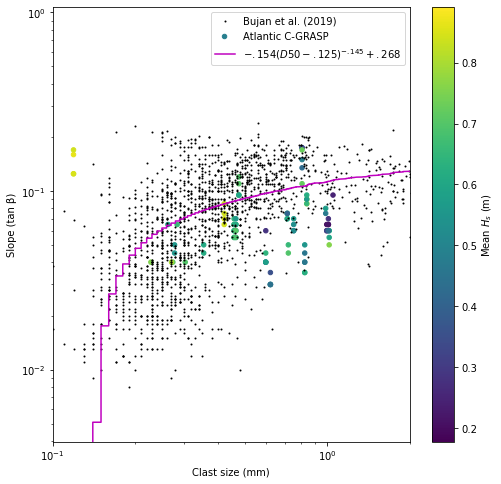

In [212]:
# plt.figure(figsize=(8,8))
# plt.loglog(bujan_dat['Clast size (mm)'], bujan_dat['Slope (tan β)'],'ko', markersize=1, label='Bujan et al. (2019)')
# # plt.scatter(gs_slope_waves['d50'], gs_slope_waves['tanBeta'],20,gs_slope_waves['hs_mean'],label='Atlantic C-GRASP')
# plt.scatter(df['d50'], df['beach_slope'],20,df['hs_mean'],label='Atlantic C-GRASP')

# plt.xlabel('Clast size (mm)')
# plt.ylabel('Slope (tan β)')
# cb = plt.colorbar()

# cb.set_label(r'Mean $H_s$ (m)')

# a = -0.154
# b = -0.145
# c = 0.268
# ln = a*( bujan_dat['Clast size (mm)'] - 0.125)**b + c

# plt.plot(np.sort(bujan_dat['Clast size (mm)']), np.sort(ln),'m', label=r'$-.154(D50 - .125)^{-.145} + .268$')

# plt.xlim(0.1,2)

# plt.legend()

# plt.savefig('CGRASP_d50-slope-waveHs.jpg', dpi=300)

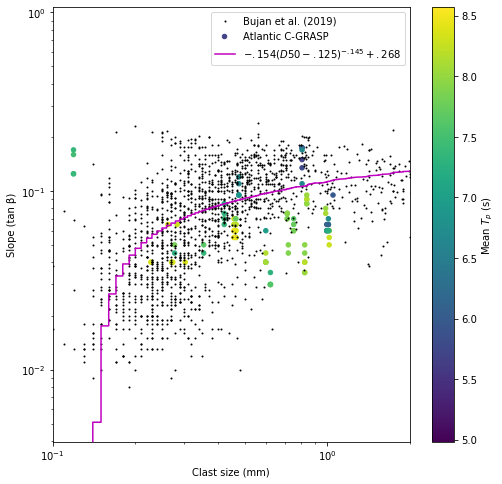

In [213]:
# plt.figure(figsize=(8,8))
# plt.loglog(bujan_dat['Clast size (mm)'], bujan_dat['Slope (tan β)'],'ko', markersize=1, label='Bujan et al. (2019)')
# # plt.scatter(gs_slope_waves['d50'], gs_slope_waves['tanBeta'],20,gs_slope_waves['hs_mean'],label='Atlantic C-GRASP')
# plt.scatter(df['d50'], df['beach_slope'],20,df['tp'],label='Atlantic C-GRASP')

# plt.xlabel('Clast size (mm)')
# plt.ylabel('Slope (tan β)')
# cb = plt.colorbar()

# cb.set_label(r'Mean $T_p$ (s)')

# a = -0.154
# b = -0.145
# c = 0.268
# ln = a*( bujan_dat['Clast size (mm)'] - 0.125)**b + c

# plt.plot(np.sort(bujan_dat['Clast size (mm)']), np.sort(ln),'m', label=r'$-.154(D50 - .125)^{-.145} + .268$')

# plt.xlim(0.1,2)

# plt.legend()

# plt.savefig('CGRASP_d50-slope-waveTp.jpg', dpi=300)

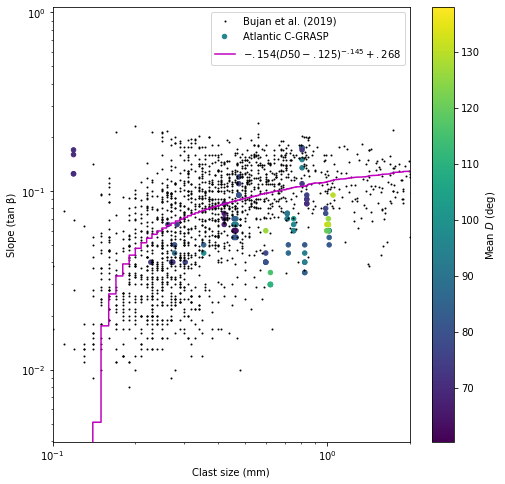

In [214]:
# plt.figure(figsize=(8,8))
# plt.loglog(bujan_dat['Clast size (mm)'], bujan_dat['Slope (tan β)'],'ko', markersize=1, label='Bujan et al. (2019)')
# # plt.scatter(gs_slope_waves['d50'], gs_slope_waves['tanBeta'],20,gs_slope_waves['hs_mean'],label='Atlantic C-GRASP')
# plt.scatter(df['d50'], df['beach_slope'],20,df['dir'],label='Atlantic C-GRASP')

# plt.xlabel('Clast size (mm)')
# plt.ylabel('Slope (tan β)')
# cb = plt.colorbar()

# cb.set_label(r'Mean $D$ (deg)')

# a = -0.154
# b = -0.145
# c = 0.268
# ln = a*( bujan_dat['Clast size (mm)'] - 0.125)**b + c

# plt.plot(np.sort(bujan_dat['Clast size (mm)']), np.sort(ln),'m', label=r'$-.154(D50 - .125)^{-.145} + .268$')

# plt.xlim(0.1,2)

# plt.legend()

# plt.savefig('CGRASP_d50-slope-waveDir.jpg', dpi=300)

In [222]:
# g=9.8
# h=10

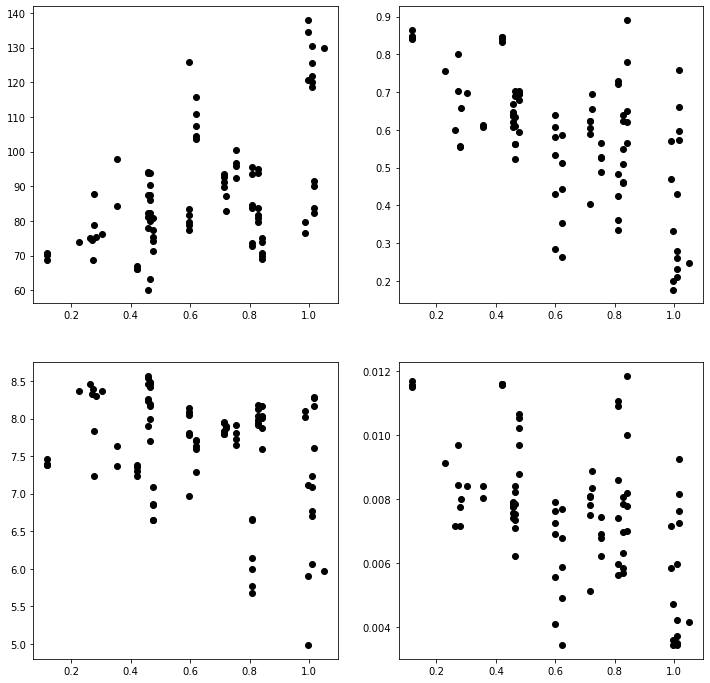

In [223]:
# plt.figure(figsize=(12,12))
# plt.subplot(221)
# plt.plot(df['d50'], df['dir'],'ko')
# plt.subplot(222)
# plt.plot(df['d50'], df['hs_mean'],'ko')
# plt.subplot(223)
# plt.plot(df['d50'], df['tp'],'ko')
# plt.subplot(224)
# #compute wavelength
# # period and wavelength are related as λ = CT
# # For shallow water waves, the phase speed, C = (gh)^0.5
# lam = df['hs_mean']/(df['tp']*((g*h)**0.5))
# plt.plot(df['d50'],lam ,'ko')